# Description

This notebook will extract representative ROI/TS for all Sbj/Run/Echo combinations and explore them

***
#### 1. Use 3dNetCorr to write text files with the representative ROI TS

```bash
cd /data/SFIMJGC/PRJ_ME-ETS/BCBL2024/code/me-ets/bash
sh ./extract_roi_ts.sh
```

***
#### 2. Load Atlas Info

In [1]:
import sys
sys.path.append('../python')

In [2]:
import os.path as osp
import os
import pandas as pd
import numpy as np
import xarray as xr
from tqdm import tqdm
import panel as pn
import hvplot.pandas
import hvplot.xarray
import holoviews as hv
pn.extension()
from utils.basics import ATLAS_DIR,ATLAS_NAME,PRCS_DATA_DIR, ECHOES, Nacqs,DATASET

In [3]:
roi_info_path = osp.join(ATLAS_DIR,f'{ATLAS_NAME}.roi_info.csv')
roi_info      = pd.read_csv(roi_info_path)
roi_names     = list(roi_info['ROI_Name'].values)
print(len(roi_names))

386


In [4]:
roi_info.sample(5)

,ROI_ID,Hemisphere,Network,ROI_Name,pos_R,pos_A,pos_S,color_R,color_G,color_B,RGB
29,30,LH,Vis,LH_Vis_30,-12,-82,36,120,20,134,#781486
17,18,LH,Vis,LH_Vis_18,-4,-88,2,120,18,138,#78128a
38,39,LH,SomMot,LH_SomMot_8,-48,-12,14,70,129,178,#4681b2
374,375,RH,Default,RH_Default_PFCdPFCm_11,14,38,52,208,62,84,#d03e54
240,241,RH,SomMot,RH_SomMot_18,52,-6,38,74,130,180,#4a82b4


***
#### 3. Load ROI Timeseries

We will be saving the ROI timeseries for all echoes in D04_TS

In [6]:
for sbj in DATASET.keys():
    ets_subfolder = osp.join(PRCS_DATA_DIR,sbj,'D04_ROIts')
    if not osp.exists(ets_subfolder):
        print('++ INFO: Creating folder [%s]' % ets_subfolder)
        os.makedirs(ets_subfolder)

++ INFO: Creating folder [/data/SFIMJGC/PRJ_ME-ETS/BCBL2024/prcs_data/P3SBJ01/D04_ROIts]
++ INFO: Creating folder [/data/SFIMJGC/PRJ_ME-ETS/BCBL2024/prcs_data/P3SBJ02/D04_ROIts]
++ INFO: Creating folder [/data/SFIMJGC/PRJ_ME-ETS/BCBL2024/prcs_data/P3SBJ03/D04_ROIts]
++ INFO: Creating folder [/data/SFIMJGC/PRJ_ME-ETS/BCBL2024/prcs_data/P3SBJ04/D04_ROIts]
++ INFO: Creating folder [/data/SFIMJGC/PRJ_ME-ETS/BCBL2024/prcs_data/P3SBJ05/D04_ROIts]
++ INFO: Creating folder [/data/SFIMJGC/PRJ_ME-ETS/BCBL2024/prcs_data/P3SBJ06/D04_ROIts]
++ INFO: Creating folder [/data/SFIMJGC/PRJ_ME-ETS/BCBL2024/prcs_data/P3SBJ07/D04_ROIts]
++ INFO: Creating folder [/data/SFIMJGC/PRJ_ME-ETS/BCBL2024/prcs_data/P3SBJ08/D04_ROIts]
++ INFO: Creating folder [/data/SFIMJGC/PRJ_ME-ETS/BCBL2024/prcs_data/P3SBJ09/D04_ROIts]
++ INFO: Creating folder [/data/SFIMJGC/PRJ_ME-ETS/BCBL2024/prcs_data/P3SBJ10/D04_ROIts]


In [7]:
%%time
for sbj in DATASET.keys():
    ets_subfolder = osp.join(PRCS_DATA_DIR,sbj,'D04_ROIts')
    
    for run in DATASET[sbj]:
        roi_ts_outpath = osp.join(ets_subfolder,f'{sbj}_{run}_MEICA_roits.nc')
        roi_ts = xr.DataArray(dims=['te','tr','roi'],
                      coords={'te':list(ECHOES.values()),
                              'tr':  np.arange(Nacqs),
                              'roi': list(roi_info['ROI_Name'].values)})
        roi_ts.name='BOLD (spc)'
        for (te_label, te) in ECHOES.items():
            roi_netts_path = osp.join(PRCS_DATA_DIR,sbj,'D02_Preprocessed',f'{sbj}_{run}_MEICA-{te_label}.{ATLAS_NAME}_000.netts')
            roi_ts.loc[te,:,:] = np.loadtxt(roi_netts_path).T

        print('++ INFO[%s,%s]: Writing multi-echo ROI ts in [%s]' %(sbj,run,roi_ts_outpath))
        roi_ts.to_netcdf(roi_ts_outpath)

++ INFO[P3SBJ01,Events01]: Writing multi-echo ROI ts in [/data/SFIMJGC/PRJ_ME-ETS/BCBL2024/prcs_data/P3SBJ01/D04_ROIts/P3SBJ01_Events01_MEICA_roits.nc]
++ INFO[P3SBJ01,Events02]: Writing multi-echo ROI ts in [/data/SFIMJGC/PRJ_ME-ETS/BCBL2024/prcs_data/P3SBJ01/D04_ROIts/P3SBJ01_Events02_MEICA_roits.nc]
++ INFO[P3SBJ02,Events01]: Writing multi-echo ROI ts in [/data/SFIMJGC/PRJ_ME-ETS/BCBL2024/prcs_data/P3SBJ02/D04_ROIts/P3SBJ02_Events01_MEICA_roits.nc]
++ INFO[P3SBJ02,Events02]: Writing multi-echo ROI ts in [/data/SFIMJGC/PRJ_ME-ETS/BCBL2024/prcs_data/P3SBJ02/D04_ROIts/P3SBJ02_Events02_MEICA_roits.nc]
++ INFO[P3SBJ03,Events01]: Writing multi-echo ROI ts in [/data/SFIMJGC/PRJ_ME-ETS/BCBL2024/prcs_data/P3SBJ03/D04_ROIts/P3SBJ03_Events01_MEICA_roits.nc]
++ INFO[P3SBJ03,Events02]: Writing multi-echo ROI ts in [/data/SFIMJGC/PRJ_ME-ETS/BCBL2024/prcs_data/P3SBJ03/D04_ROIts/P3SBJ03_Events02_MEICA_roits.nc]
++ INFO[P3SBJ04,Events01]: Writing multi-echo ROI ts in [/data/SFIMJGC/PRJ_ME-ETS/BCBL20

***
### Explore data for one subject

In [8]:
import seaborn as sns
from sfim_lib.atlases.plotting import hvplot_fc

/data/SFIMJGC_HCP7T/Apps/envs/me_ets_2024a/lib/python3.9/site-packages/nxviz/__init__.py:18: UserWarning: 
nxviz has a new API! Version 0.7.4 onwards, the old class-based API is being
deprecated in favour of a new API focused on advancing a grammar of network
graphics. If your plotting code depends on the old API, please consider
pinning nxviz at version 0.7.4, as the new API will break your old code.

To check out the new API, please head over to the docs at
https://ericmjl.github.io/nxviz/ to learn more. We hope you enjoy using it!

(This deprecation message will go away in version 1.0.)

  warnings.warn(


In [9]:
sbj='P3SBJ06'
run='Events01'
pp='MEICA'
roi_ts = xr.open_dataarray(f'/data/SFIMJGC/PRJ_ME-ETS/BCBL2024/prcs_data/{sbj}/D04_ROIts/{sbj}_{run}_{pp}_roits.nc')

In [10]:
FC_E01 = pd.DataFrame(roi_ts.sel(te=16.3).values).corr()
FC_E01.columns,FC_E01.index = roi_names,roi_names
FC_E02 = pd.DataFrame(roi_ts.sel(te=32.2).values).corr()
FC_E02.columns,FC_E02.index = roi_names,roi_names
FC_E03 = pd.DataFrame(roi_ts.sel(te=48.1).values).corr()
FC_E03.columns,FC_E03.index = roi_names,roi_names

In [11]:
pn.Row(hvplot_fc(FC_E01,roi_info_path,major_label_overrides='regular_grid',cmap='RdBu_r'),
       hvplot_fc(FC_E02,roi_info_path,major_label_overrides='regular_grid',cmap='RdBu_r'),
       hvplot_fc(FC_E03,roi_info_path,major_label_overrides='regular_grid',cmap='RdBu_r'))

Row
    [0] HoloViews(Overlay, sizing_mode='fixed')
    [1] HoloViews(Overlay, sizing_mode='fixed')
    [2] HoloViews(Overlay, sizing_mode='fixed')

***

#### Let's see how FC works across echoes

In [153]:
import random

In [154]:
roi1,roi2 = random.sample(roi_names,2)

In [160]:
#roi1,roi2 = 'LH_SomMot_2','RH_SomMot_37'
roi1,roi2 = 'RH_Vis_22','LH_Vis_21'
#roi1,roi2 = random.sample(roi_names,2)
r = []
tes = []
for e1 in ECHOES.values():
    for e2 in ECHOES.values():
        aux_ts01 = roi_ts.sel(roi=roi1,te=e1)
        aux_ts02 = roi_ts.sel(roi=roi2,te=e2)
        tes.append(e1*e2)
        r.append(np.corrcoef(aux_ts01,aux_ts02)[0,1])

In [161]:
pd.DataFrame(np.array([tes,r]).T,columns=['tes','R']).hvplot.scatter(x='tes',y='R',title='%s - %s' % (roi1,roi2),ylim=(-1,1))

:Scatter   [tes]   (R)

In [159]:
roi1,roi2 = 'RH_Vis_22','LH_Vis_21'#'RH_SomMot_29'
e01_R = np.corrcoef(roi_ts.sel(roi=[roi1,roi2],te=16.3).to_numpy().T)[0,1]
e02_R = np.corrcoef(roi_ts.sel(roi=[roi1,roi2],te=32.2).to_numpy().T)[0,1]
e03_R = np.corrcoef(roi_ts.sel(roi=[roi1,roi2],te=48.1).to_numpy().T)[0,1]
(roi_ts.sel(roi=[roi1,roi2],te=16.3).hvplot(x='tr', by='roi', width=1000, legend='top_left')*hv.Text(150,0.015,'R=%.2f'%e01_R) + \
 roi_ts.sel(roi=[roi1,roi2],te=32.2).hvplot(x='tr', by='roi', width=1000, legend='top_left')*hv.Text(150,0.015,'R=%.2f'%e02_R) + \
 roi_ts.sel(roi=[roi1,roi2],te=48.1).hvplot(x='tr', by='roi', width=1000, legend='top_left')*hv.Text(150,0.015,'R=%.2f'%e03_R)).cols(1)

:Layout
   .Overlay.I   :Overlay
      .NdOverlay.I :NdOverlay   [roi]
         :Curve   [tr]   (BOLD (spc))
      .Text.I      :Text   [x,y]
   .Overlay.II  :Overlay
      .NdOverlay.I :NdOverlay   [roi]
         :Curve   [tr]   (BOLD (spc))
      .Text.I      :Text   [x,y]
   .Overlay.III :Overlay
      .NdOverlay.I :NdOverlay   [roi]
         :Curve   [tr]   (BOLD (spc))
      .Text.I      :Text   [x,y]

In [76]:
roi1_e01_ts = roi_ts.sel(roi=[roi1],te=16.3).to_dataframe().reset_index().drop(['roi','te'],axis=1).set_index('tr')
roi2_e01_ts = roi_ts.sel(roi=[roi2],te=16.3).to_dataframe().reset_index().drop(['roi','te'],axis=1).set_index('tr')
pd.concat

In [99]:
sel_ts = roi_ts.sel(roi=[roi1,roi2]).to_dataframe()
sel_ts.reset_index().pivot(columns=['BOLD (spc)'])

te                                                    \
BOLD (spc) -0.010990 -0.010880 -0.010580 -0.010170 -0.010120 -0.010090   
0                NaN       NaN       NaN       NaN       NaN       NaN   
1                NaN       NaN       NaN       NaN       NaN       NaN   
2                NaN       NaN       NaN       NaN       NaN       NaN   
3                NaN       NaN       NaN       NaN       NaN       NaN   
4                NaN       NaN       NaN       NaN       NaN       NaN   
...              ...       ...       ...       ...       ...       ...   
1285             NaN       NaN       NaN       NaN       NaN       NaN   
1286             NaN       NaN       NaN       NaN       NaN       NaN   
1287             NaN       NaN       NaN       NaN       NaN       NaN   
1288             NaN       NaN       NaN       NaN       NaN       NaN   
1289             NaN       NaN       NaN       NaN       NaN       NaN   

                                                    ...       roi            \
BOLD (spc) -0.009804 -0.009751 -0.009468 -0.009273  ...  0.011590  0.011600   
0                NaN       NaN       NaN       NaN  ...       NaN       NaN   
1                NaN       NaN       NaN       NaN  ...       NaN       NaN   
2                NaN       NaN       NaN       NaN  ...       NaN       NaN   
3                NaN       NaN       NaN       NaN  ...       NaN       NaN   
4                NaN       NaN       NaN       NaN  ...       NaN       NaN   
...              ...       ...       ...       ...  ...       ...       ...   
1285             NaN       NaN       NaN       NaN  ...       NaN       NaN   
1286             NaN       NaN       NaN       NaN  ...       NaN       NaN   
1287             NaN       NaN       NaN       NaN  ...       NaN       NaN   
1288             NaN       NaN       NaN       NaN  ...       NaN       NaN   
1289             NaN       NaN       NaN       NaN  ...       NaN       NaN   

                                                                        \
BOLD (spc)  0.012760  0.012790  0.013080  0.014170  0.015320  0.015500   
0                NaN       NaN       NaN       NaN       NaN       NaN   
1                NaN       NaN       NaN       NaN       NaN       NaN   
2                NaN       NaN       NaN       NaN       NaN       NaN   
3                NaN       NaN       NaN       NaN       NaN       NaN   
4                NaN       NaN       NaN       NaN       NaN       NaN   
...              ...       ...       ...       ...       ...       ...   
1285             NaN       NaN       NaN       NaN       NaN       NaN   
1286             NaN       NaN       NaN       NaN       NaN       NaN   
1287             NaN       NaN       NaN       NaN       NaN       NaN   
1288             NaN       NaN       NaN       NaN       NaN       NaN   
1289             NaN       NaN       NaN       NaN       NaN       NaN   

                                
BOLD (spc)  0.015840  0.017280  
0                NaN       NaN  
1                NaN       NaN  
2                NaN       NaN  
3                NaN       NaN  
4                NaN       NaN  
...              ...       ...  
1285             NaN       NaN  
1286             NaN       NaN  
1287             NaN       NaN  
1288             NaN       NaN  
1289             NaN       NaN  

[1290 rows x 3693 columns]

In [8]:
from nilearn.connectome import sym_matrix_to_vec, vec_to_sym_matrix
from itertools import combinations
import holoviews as hv

In [9]:
FC_E01_vector = sym_matrix_to_vec(FC_E01.values, discard_diagonal=True)
FC_E02_vector = sym_matrix_to_vec(FC_E02.values, discard_diagonal=True)
FC_E03_vector = sym_matrix_to_vec(FC_E03.values, discard_diagonal=True)

In [10]:
FC_vectors_idx = pd.MultiIndex.from_tuples([e for e in combinations(roi_names[::-1],2)][::-1], names=['ROI_x','ROI_y'])
FC_vectors = pd.DataFrame(np.array([FC_E01_vector, FC_E02_vector, FC_E03_vector]).T,columns=['E01','E02','E03'], index=FC_vectors_idx)
FC_vectors.name = 'FC'
FC_vectors.columns.nams='Echoes'

In [40]:
FC_vectors.reset_index().hvplot.scatter(x='E01',y='E02',hover_cols=['ROI_x','ROI_y'],s=1,aspect='square',frame_width=400) * hv.Curve([[-1, -1], [1, 1]]).opts(line_dash='dashed', color='black', line_width=0.5) + \
FC_vectors.reset_index().hvplot.scatter(x='E01',y='E03',hover_cols=['ROI_x','ROI_y'],s=1,aspect='square',frame_width=400) * hv.Curve([[-1, -1], [1, 1]]).opts(line_dash='dashed', color='black', line_width=0.5) + \
FC_vectors.reset_index().hvplot.scatter(x='E02',y='E03',hover_cols=['ROI_x','ROI_y'],s=1,aspect='square',frame_width=400) * hv.Curve([[-1, -1], [1, 1]]).opts(line_dash='dashed', color='black', line_width=0.5) 

:Layout
   .Overlay.I   :Overlay
      .Scatter.I :Scatter   [E01]   (E02,ROI_x,ROI_y)
      .Curve.I   :Curve   [x]   (y)
   .Overlay.II  :Overlay
      .Scatter.I :Scatter   [E01]   (E03,ROI_x,ROI_y)
      .Curve.I   :Curve   [x]   (y)
   .Overlay.III :Overlay
      .Scatter.I :Scatter   [E02]   (E03,ROI_x,ROI_y)
      .Curve.I   :Curve   [x]   (y)

In [11]:
from utils.ets import get_ets

SyntaxError: invalid syntax (ets.py, line 12)

In [60]:
ets_spc    = get_ets(roi_ts.sel(te=32.2),roi_ts.sel(te=48.1))
ets_zscore = get_ets(roi_ts.sel(te=32.2),roi_ts.sel(te=48.1), normalize=True)

In [63]:
ets_spc.name

'ETS (As is)'

In [66]:
(ets_spc['LH_Vis_1-LH_Vis_8'].hvplot(shared_axes=False) + \
ets_zscore['LH_Vis_1-LH_Vis_8'].hvplot(shared_axes=False)).cols(1)

:Layout
   .Curve.LH_Vis_1_hyphen_minus_LH_Vis_8.I  :Curve   [index]   (LH_Vis_1-LH_Vis_8)
   .Curve.LH_Vis_1_hyphen_minus_LH_Vis_8.II :Curve   [index]   (LH_Vis_1-LH_Vis_8)

In [56]:
ets_spc_e01_e01 = get_ets(roi_ts.sel(te=16.3),roi_ts.sel(te=16.3))
ets_spc_e01_e02 = get_ets(roi_ts.sel(te=16.3),roi_ts.sel(te=32.2))
ets_spc_e01_e03 = get_ets(roi_ts.sel(te=16.3),roi_ts.sel(te=48.1))
ets_spc_e01_e01['LH_Vis_1-LH_Vis_8'].hvplot()*ets_spc_e01_e02['LH_Vis_1-LH_Vis_8'].hvplot()*ets_spc_e01_e03['LH_Vis_1-LH_Vis_8'].hvplot(width=1000)

:Overlay
   .Curve.LH_Vis_1_hyphen_minus_LH_Vis_8.I   :Curve   [index]   (LH_Vis_1-LH_Vis_8)
   .Curve.LH_Vis_1_hyphen_minus_LH_Vis_8.II  :Curve   [index]   (LH_Vis_1-LH_Vis_8)
   .Curve.LH_Vis_1_hyphen_minus_LH_Vis_8.III :Curve   [index]   (LH_Vis_1-LH_Vis_8)

In [57]:
ets_spc_e01_e01 = get_ets(roi_ts.sel(te=16.3),roi_ts.sel(te=16.3), normalize=True)
ets_spc_e01_e02 = get_ets(roi_ts.sel(te=16.3),roi_ts.sel(te=32.2), normalize=True)
ets_spc_e01_e03 = get_ets(roi_ts.sel(te=16.3),roi_ts.sel(te=48.1), normalize=True)
ets_spc_e01_e01['LH_Vis_1-LH_Vis_8'].hvplot()*ets_spc_e01_e02['LH_Vis_1-LH_Vis_8'].hvplot()*ets_spc_e01_e03['LH_Vis_1-LH_Vis_8'].hvplot(width=1000)

:Overlay
   .Curve.LH_Vis_1_hyphen_minus_LH_Vis_8.I   :Curve   [index]   (LH_Vis_1-LH_Vis_8)
   .Curve.LH_Vis_1_hyphen_minus_LH_Vis_8.II  :Curve   [index]   (LH_Vis_1-LH_Vis_8)
   .Curve.LH_Vis_1_hyphen_minus_LH_Vis_8.III :Curve   [index]   (LH_Vis_1-LH_Vis_8)

In [59]:
import scipy as sp
def get_ets(ts1, ts2=None, normalize=False): 
    # make edge time series
    # input:     
    #    timeseies, size: time x channel
    # output:    
    #    edge timeseries, size time x |channels*(channels-1)/2|
    # If only one ts is provided, we assume we are doing that to itself
    roi_names  = None
    if isinstance(ts1,xr.core.dataarray.DataArray):
        if 'roi' in ts1.dims:
            roi_names = list(roi_ts.sel(te=32.2).roi.values)
        ts1 = ts1.values
    if ts2 is None:
        ts2 = ts1
    else:
        if isinstance(ts2,xr.core.dataarray.DataArray):
            ts2 = ts2.values
   
    assert ts1.shape == ts2.shape, "++ ERROR [get_ets]: Timeseries shape do not match."
        
    # zscore the input timeseries
    if normalize:
        z1 = sp.stats.zscore(np.asarray(ts1),0)    
        z2 = sp.stats.zscore(np.asarray(ts2),0)
    else:
        z1 = ts1
        z2 = ts2
        
    T, N= ts1.shape
    u,v = np.where(np.triu(np.ones(N),1))           # get edges
    # element-wise prroduct of time series
    ets = (z1[:,u]*z2[:,v])

    if roi_names is not None:
        # Create edge names
        edge_list_tuples = [e for e in combinations(roi_names,2)]
        edge_list_idx    = ['-'.join(e) for e in edge_list_tuples]

        ets = pd.DataFrame(ets,columns=edge_list_idx)
    if normalize:
        ets.name = 'ETS (Z-Scored)'
    else:
        ets.name = 'ETS (As is)'
    return ets


In [138]:
FC_E01

,LH_Vis_1,LH_Vis_2,LH_Vis_3,LH_Vis_4,LH_Vis_5,LH_Vis_6,LH_Vis_7,LH_Vis_8,LH_Vis_9,LH_Vis_10,...,RH_Default_PFCdPFCm_13,RH_Default_pCunPCC_1,RH_Default_pCunPCC_2,RH_Default_pCunPCC_3,RH_Default_pCunPCC_4,RH_Default_pCunPCC_5,RH_Default_pCunPCC_6,RH_Default_pCunPCC_7,RH_Default_pCunPCC_8,RH_Default_pCunPCC_9
LH_Vis_1,1.000000,0.617349,0.575104,0.628576,0.685922,0.412684,0.284896,0.113368,0.317952,0.404327,...,0.086352,0.300237,0.047659,0.303673,0.003839,0.119650,0.220527,0.208796,0.003558,-0.033819
LH_Vis_2,0.617349,1.000000,0.480882,0.603392,0.606083,0.364289,0.337899,0.086984,0.226608,0.309215,...,-0.064149,0.590902,0.207457,0.179802,0.235270,0.226288,0.213642,0.122272,0.056850,0.020894
LH_Vis_3,0.575104,0.480882,1.000000,0.700957,0.818189,0.852366,0.226167,0.608053,0.503655,0.419893,...,0.059396,0.215228,0.067521,0.297387,-0.164471,-0.019042,0.047712,0.051018,-0.267067,-0.263204
LH_Vis_4,0.628576,0.603392,0.700957,1.000000,0.845702,0.577253,0.329862,0.163961,0.402730,0.600540,...,0.080335,0.383532,0.130422,0.342337,-0.015265,0.101279,0.163779,0.166695,-0.126743,-0.132291
LH_Vis_5,0.685922,0.606083,0.818189,0.845702,1.000000,0.709158,0.293732,0.250159,0.609631,0.628355,...,0.143304,0.404914,0.163315,0.402591,0.032066,0.176392,0.215268,0.230365,-0.087769,-0.126058
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
RH_Default_pCunPCC_5,0.119650,0.226288,-0.019042,0.101279,0.176392,-0.109507,0.148367,-0.387294,0.241610,0.261280,...,0.185767,0.453906,0.634778,0.542147,0.784419,1.000000,0.751806,0.635040,0.738208,0.638124
RH_Default_pCunPCC_6,0.220527,0.213642,0.047712,0.163779,0.215268,-0.061466,0.298705,-0.385905,0.306907,0.280455,...,0.141369,0.437173,0.573770,0.475900,0.653331,0.751806,1.000000,0.763011,0.641933,0.739413
RH_Default_pCunPCC_7,0.208796,0.122272,0.051018,0.166695,0.230365,-0.064008,0.294706,-0.412419,0.364072,0.270674,...,0.376518,0.311141,0.482977,0.481426,0.494515,0.635040,0.763011,1.000000,0.561463,0.622855
RH_Default_pCunPCC_8,0.003558,0.056850,-0.267067,-0.126743,-0.087769,-0.294791,0.101776,-0.410726,0.148284,-0.017372,...,0.323440,0.164282,0.401300,0.187373,0.723147,0.738208,0.641933,0.561463,1.000000,0.659504


In [143]:
FC_E01_vector[0:10]

array([0.61734928, 0.57510447, 0.48088167, 0.6285759 , 0.6033924 ,
       0.70095686, 0.68592161, 0.60608289, 0.81818892, 0.84570217])

In [140]:
[e for e in combinations(roi_names[::-1],2)][::-1][0:10]

[('LH_Vis_2', 'LH_Vis_1'),
 ('LH_Vis_3', 'LH_Vis_1'),
 ('LH_Vis_3', 'LH_Vis_2'),
 ('LH_Vis_4', 'LH_Vis_1'),
 ('LH_Vis_4', 'LH_Vis_2'),
 ('LH_Vis_4', 'LH_Vis_3'),
 ('LH_Vis_5', 'LH_Vis_1'),
 ('LH_Vis_5', 'LH_Vis_2'),
 ('LH_Vis_5', 'LH_Vis_3'),
 ('LH_Vis_5', 'LH_Vis_4')]

In [112]:
from itertools import product, combinations, permutations

In [135]:
pd.MultiIndex.from_product([roi_names,roi_names])[0:10]

MultiIndex([('LH_Vis_1',  'LH_Vis_1'),
            ('LH_Vis_1',  'LH_Vis_2'),
            ('LH_Vis_1',  'LH_Vis_3'),
            ('LH_Vis_1',  'LH_Vis_4'),
            ('LH_Vis_1',  'LH_Vis_5'),
            ('LH_Vis_1',  'LH_Vis_6'),
            ('LH_Vis_1',  'LH_Vis_7'),
            ('LH_Vis_1',  'LH_Vis_8'),
            ('LH_Vis_1',  'LH_Vis_9'),
            ('LH_Vis_1', 'LH_Vis_10')],
           )

In [131]:
roi_names

['LH_Vis_1',
 'LH_Vis_2',
 'LH_Vis_3',
 'LH_Vis_4',
 'LH_Vis_5',
 'LH_Vis_6',
 'LH_Vis_7',
 'LH_Vis_8',
 'LH_Vis_9',
 'LH_Vis_10',
 'LH_Vis_11',
 'LH_Vis_12',
 'LH_Vis_13',
 'LH_Vis_14',
 'LH_Vis_15',
 'LH_Vis_16',
 'LH_Vis_17',
 'LH_Vis_18',
 'LH_Vis_19',
 'LH_Vis_20',
 'LH_Vis_21',
 'LH_Vis_22',
 'LH_Vis_23',
 'LH_Vis_24',
 'LH_Vis_25',
 'LH_Vis_26',
 'LH_Vis_27',
 'LH_Vis_28',
 'LH_Vis_29',
 'LH_Vis_30',
 'LH_Vis_31',
 'LH_SomMot_1',
 'LH_SomMot_2',
 'LH_SomMot_3',
 'LH_SomMot_4',
 'LH_SomMot_5',
 'LH_SomMot_6',
 'LH_SomMot_7',
 'LH_SomMot_8',
 'LH_SomMot_9',
 'LH_SomMot_10',
 'LH_SomMot_11',
 'LH_SomMot_12',
 'LH_SomMot_13',
 'LH_SomMot_14',
 'LH_SomMot_15',
 'LH_SomMot_16',
 'LH_SomMot_17',
 'LH_SomMot_18',
 'LH_SomMot_19',
 'LH_SomMot_20',
 'LH_SomMot_21',
 'LH_SomMot_22',
 'LH_SomMot_23',
 'LH_SomMot_24',
 'LH_SomMot_25',
 'LH_SomMot_26',
 'LH_SomMot_27',
 'LH_SomMot_28',
 'LH_SomMot_29',
 'LH_SomMot_30',
 'LH_SomMot_31',
 'LH_SomMot_32',
 'LH_SomMot_33',
 'LH_SomMot_34',
 'LH_S

In [120]:
386*385/2

74305.0

In [62]:
FC_E01_vector = sym_matrix_to_vec(FC_E01.values)
FC_E02_vector = sym_matrix_to_vec(FC_E02.values)
FC_E03_vector = sym_matrix_to_vec(FC_E03.values)

In [83]:
FC_vectors = pd.DataFrame(np.array([FC_E01_vector, FC_E02_vector, FC_E03_vector]).T,columns=['E01','E02','E03'])
FC_vectors.name = 'FC'
FC_vectors.columns.name = 'Echoes'
FC_vectors.index.name = 'Edges'

In [97]:
scat_e01_vs_e02 = FC_vectors.hvplot.scatter(x='E01',y='E02',aspect='square',s=1,c='b')
e01_vs_e02      = scat_e01_vs_e02 * hv.Slope.from_scatter(scat_e01_vs_e02).opts(line_width=0.5,line_color='b',line_dash='dashed')
scat_e01_vs_e03 = FC_vectors.hvplot.scatter(x='E01',y='E03',aspect='square',s=1,c='r')
e01_vs_e03      = scat_e01_vs_e03 * hv.Slope.from_scatter(scat_e01_vs_e03).opts(line_width=0.5,line_color='r',line_dash='dashed')
scat_e02_vs_e03 = FC_vectors.hvplot.scatter(x='E02',y='E03',aspect='square',s=1,c='g')
e02_vs_e03      = scat_e02_vs_e03 * hv.Slope.from_scatter(scat_e02_vs_e03).opts(line_width=0.5,line_color='g',line_dash='dashed')
pn.Row(e01_vs_e02*e01_vs_e03*e02_vs_e03)

Row
    [0] HoloViews(Overlay, sizing_mode='fixed')

In [2]:
aux_path = '/data/SFIMJGC/PRJ_ME-ETS/BCBL2024/prcs_data/P3SBJ02/D02_Preprocessed/P3SBJ02_Events01_MEICA-E01.Schaefer2018_400Parcels_7Networks_000.roidat'

In [3]:
roidat_df = pd.read_csv(aux_path,sep=' ', skipinitialspace=True, header=0)
correct_columns = roidat_df.columns.drop(['#'])
roidat_df = roidat_df.drop(['ROI_label'],axis=1)
roidat_df.columns = correct_columns
roidat_df = roidat_df.drop(['#.1'],axis=1)

In [5]:
roidat_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 386 entries, 0 to 385
Data columns (total 5 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   N_vox      386 non-null    int64  
 1   N_nonnull  386 non-null    int64  
 2   frac       386 non-null    float64
 3   ROI        386 non-null    int64  
 4   ROI_label  386 non-null    object 
dtypes: float64(1), int64(3), object(1)
memory usage: 15.2+ KB


In [10]:
roidat_df.sort_values(by='frac')

,N_vox,N_nonnull,frac,ROI,ROI_label
116,396,72,0.18182,117,7Networks_LH_Limbic_TempPole_5
114,604,180,0.29801,115,7Networks_LH_Limbic_TempPole_1
315,481,167,0.34719,316,7Networks_RH_Limbic_TempPole_4
312,229,83,0.36245,313,7Networks_RH_Limbic_OFC_4
68,363,147,0.40496,69,7Networks_LH_DorsAttn_Post_1
...,...,...,...,...,...
37,203,203,1.00000,38,7Networks_LH_SomMot_7
38,239,239,1.00000,39,7Networks_LH_SomMot_8
39,232,232,1.00000,40,7Networks_LH_SomMot_9
40,208,208,1.00000,41,7Networks_LH_SomMot_10


## Link Files from original ME-PFM Project

```bash
cd ${DATA_DIR}/BCBL2024/prcs_data/P3SBJ06/
ln -s /data/SFIMJGC/PRJ_MEPFM/PrcsData/P3SBJ06/D02_InMNISpace/pc04.P3SBJ06_Events01_E01.spc.nii.gz .
ln -s /data/SFIMJGC/PRJ_MEPFM/PrcsData/P3SBJ06/D02_InMNISpace/pc04.P3SBJ06_Events01_E02.spc.nii.gz .
ln -s /data/SFIMJGC/PRJ_MEPFM/PrcsData/P3SBJ06/D02_InMNISpace/pc04.P3SBJ06_Events01_E03.spc.nii.gz .
ln -s /data/SFIMJGC/PRJ_MEPFM/PrcsData/P3SBJ06/D02_InMNISpace/P3SBJ06_Events01.REF.mask.FBrain.MNI.nii.gz .
ln -s ../../atlases/Schaefer2018_400Parcels_7Networks/Schaefer2018_400Parcels_7Networks_order_FSLMNI152_2mm.nii.gz .

3dcopy /data/SFIMJGC/PRJ_MEPFM/PrcsData/P3SBJ06/D02_InMNISpace/P3SBJ06_Anat_bc_ns+tlrc. P3SBJ06_Anat.nii
```

### Minor Atlas Editing
```bash
cd ${ATLAS_DIR}
3drefit -space MNI Schaefer2018_400Parcels_7Networks_order_FSLMNI152_2mm.nii.gz
@MakeLabelTable -lab_file Schaefer2018_400Parcels_7Networks_order.txt 1 0 -labeltable Schaefer2018_400Parcels_7Networks.niml.lt -dset Schaefer2018_400Parcels_7Networks_order_FSLMNI152_2mm.nii.gz
```

## Extract ROI timeseries

```bash
cd ${DATA_DIR}/BCBL2024/prcs_data/P3SBJ06/
3dNetCorr -overwrite -mask P3SBJ06_Events01.REF.mask.FBrain.MNI.nii.gz \
                     -inset pc04.P3SBJ06_Events01_E01.spc.nii.gz \
                     -in_rois Schaefer2018_400Parcels_7Networks_order_FSLMNI152_2mm.nii.gz \
                     -prefix P3SBJ06_Events01_E01.Schaefer2018_400Parcels_7Networks \
                     -ts_out
3dNetCorr -overwrite -mask P3SBJ06_Events01.REF.mask.FBrain.MNI.nii.gz \
                     -inset pc04.P3SBJ06_Events01_E02.spc.nii.gz \
                     -in_rois Schaefer2018_400Parcels_7Networks_order_FSLMNI152_2mm.nii.gz \
                     -prefix P3SBJ06_Events01_E02.Schaefer2018_400Parcels_7Networks \
                     -ts_out
3dNetCorr -overwrite -mask P3SBJ06_Events01.REF.mask.FBrain.MNI.nii.gz \
                     -inset pc04.P3SBJ06_Events01_E03.spc.nii.gz \
                     -in_rois Schaefer2018_400Parcels_7Networks_order_FSLMNI152_2mm.nii.gz \
                     -prefix P3SBJ06_Events01_E03.Schaefer2018_400Parcels_7Networks \
                     -ts_out
```

***

In [1]:
import os.path as osp
import pandas as pd
import numpy as np
import hvplot.pandas
import hvplot.xarray
from scipy import stats
import xarray as xr
from tqdm import tqdm
from holoviews import opts
import holoviews as hv
from itertools import permutations, combinations, product
from scipy.stats import linregress
import random
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
import panel as pn

In [3]:
# Code Provides by Josh Faskowitz
# def get_ets(ts, normalize=False): 
#     # make edge time series
#     # input:     
#     #    timeseies, size: time x channel
#     # output:    
#     #    edge timeseries, size time x |channels*(channels-1)/2|

#     # zscore the input timeseries
#     if normalize:
#         z = sp.stats.zscore(np.asarray(ts),0)    
#     else:
#         z = ts
    
#     T, N= ts.shape
#     u,v = np.where(np.triu(np.ones(N),1))           # get edges
#     # element-wise prroduct of time series
#     ets = (z[:,u]*z[:,v])
    
#     return ets

# Code Provides by Josh Faskowitz
def get_ets(ts1, ts2=None, normalize=False): 
    # make edge time series
    # input:     
    #    timeseies, size: time x channel
    # output:    
    #    edge timeseries, size time x |channels*(channels-1)/2|
    # If only one ts is provided, we assume we are doing that to itself
    if ts2 is None:
        ts2 = ts1
    assert ts1.shape == ts2.shape, "++ ERROR [get_ets]: Timeseries shape do not match."
    # zscore the input timeseries
    if normalize:
        z1 = sp.stats.zscore(np.asarray(ts1),0)    
        z2 = sp.stats.zscore(np.asarray(ts2),0)
    else:
        z1 = ts1
        z2 = ts2
    
    T, N= ts1.shape
    u,v = np.where(np.triu(np.ones(N),1))           # get edges
    # element-wise prroduct of time series
    ets = (z1[:,u]*z2[:,v])
    
    return ets

def edges_2_mat(edges,sizemat,diagval=1):
    # make vector of edge values into symmetric matrix
    # need to supply the original size of the matrix where edge come from
    
    mat = np.zeros([sizemat,sizemat])     # initialize matrix 
    mat[np.triu_indices(sizemat,k=1)] = edges # add edges
    mat = np.triu(mat,k=1) + np.triu(mat,k=1).T # make symmetric
    mat[np.diag_indices(sizemat)] = diagval # set diagonal 
    
    return mat

In [4]:
DATA_DIR      = '/data/SFIMJGC/PRJ_ME-ETS/BCBL2024/prcs_data/'
SBJ           = 'P3SBJ06'
RUN           = 'Events01'
ECHOES        = {'E01':16.3,'E02':32.2,'E03':48.1} # in miliseconds
Nacqs         = 215
Nrois         = 400
Ncons         = int(Nrois*(Nrois-1)/2)
REP_ROI01     = 'ROI209'
REP_ROI02     = 'ROI008'
REP_TR        = 14

In [5]:
ROI_LIST = ['R'+str(r).zfill(3) for r in range(Nrois)]
print('++ Number of ROI Names: %d' % len(ROI_LIST))

++ Number of ROI Names: 400


In [6]:
EDGE_LIST_TUPLES = [e for e in combinations(ROI_LIST,2)]
EDGE_LIST_STRINGS = [a+'-'+b for (a,b) in EDGE_LIST_TUPLES]
print('++ Number of Edges: %d' % len(EDGE_LIST_TUPLES))
print('++ EDGE_LIST_TUPLES=%s' % str(EDGE_LIST_TUPLES[0:5]))
print('++ EDGE_LIST_STRINGS=%s' % str(EDGE_LIST_STRINGS[0:5]))

++ Number of Edges: 79800
++ EDGE_LIST_TUPLES=[('R000', 'R001'), ('R000', 'R002'), ('R000', 'R003'), ('R000', 'R004'), ('R000', 'R005')]
++ EDGE_LIST_STRINGS=['R000-R001', 'R000-R002', 'R000-R003', 'R000-R004', 'R000-R005']


In [7]:
echo_label_combs = [i for i in product(ECHOES.keys(),repeat=2)]
echo_times_combs = [i for i in product(ECHOES.values(),repeat=2)]
echo_times_mults = np.array([i*j for i,j in echo_times_combs]).round(2)
print('++INFO: echo_label_combs =' , echo_label_combs)
print('++INFO: echo_times_comns =' , echo_times_combs)
print('++INFO: echo_times_mult  =' , echo_times_mults)

++INFO: echo_label_combs = [('E01', 'E01'), ('E01', 'E02'), ('E01', 'E03'), ('E02', 'E01'), ('E02', 'E02'), ('E02', 'E03'), ('E03', 'E01'), ('E03', 'E02'), ('E03', 'E03')]
++INFO: echo_times_comns = [(16.3, 16.3), (16.3, 32.2), (16.3, 48.1), (32.2, 16.3), (32.2, 32.2), (32.2, 48.1), (48.1, 16.3), (48.1, 32.2), (48.1, 48.1)]
++INFO: echo_times_mult  = [ 265.69  524.86  784.03  524.86 1036.84 1548.82  784.03 1548.82 2313.61]


## 1. Load ROI Timeseries

We first load the timeseries for all ROIs into a xArray with dimensions: echo time, acquisition, ROI.

In [8]:
roi_ts = xr.DataArray(dims=['te','tr','roi'],
                  coords={'te':list(ECHOES.values()),
                          'tr':  np.arange(Nacqs),
                          'roi': ROI_LIST})
roi_ts.name = 'BOLD Signal Percent Change'

In [9]:
for (ECHO_LABEL, ECHO_TIME) in tqdm(ECHOES.items(), desc='Echo'):
    aux_roits_path = osp.join(DATA_DIR,SBJ,f'{SBJ}_{RUN}_{ECHO_LABEL}.Schaefer2018_400Parcels_7Networks_000.netts')
    roi_ts.loc[ECHO_TIME,:,:] = np.loadtxt(aux_roits_path).T

Echo: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 70.43it/s]


In [10]:
roi_ts.to_netcdf('../temp/roi_ts.nc')

## 2. Compute Edge Timeseries 

In [13]:
edge_ts = xr.DataArray(dims=['TEs','TR','Edge'],
                       coords={'TEs':[str(a)+'x'+str(b) for (a,b) in echo_times_combs],
                               'TR':range(Nacqs),
                               'Edge':EDGE_LIST_STRINGS})
edge_ts.name = 'ETS'

In [14]:
for i in tqdm(range(len(echo_times_mults))):
    te_t1,te_t2 = echo_times_combs[i]
    aux_ts1 = roi_ts.sel(TE=te_t1).values
    aux_ts2 = roi_ts.sel(TE=te_t2).values
    edge_ts.loc[str(te_t1)+'x'+str(te_t2),:,:] = get_ets(aux_ts1,aux_ts2)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.65it/s]


In [15]:
edge_ts.to_netcdf('../temp/edge_ts.nc')

## 4. Compute Certainty (R^2) across all echo combinations

In [16]:
ets_stats =xr.DataArray(dims=['Metric','TR','Edge'],
                       coords={'Metric':['R2','Slope','Intercept','R','p_value'],
                               'TR':range(Nacqs),
                               'Edge':EDGE_LIST_STRINGS})
ets_stats.name = 'ETS_Stats'

for edge in tqdm(EDGE_LIST_STRINGS):
    for tr in range(Nacqs):
        slope, intercept, r_value, p_value, std_err = linregress(echo_times_mults, edge_ts.sel(Edge=edge,TR=tr).values)
        ets_stats.loc['R2',tr,edge] = r_value*r_value
        ets_stats.loc['R',tr,edge] = r_value
        ets_stats.loc['p_value',tr,edge] = p_value
        ets_stats.loc['Slope',tr,edge] = slope
        ets_stats.loc['Intercept',tr,edge] = intercept

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 79800/79800 [5:56:13<00:00,  3.73it/s]


In [17]:
ets_stats.to_netcdf('../temp/ets_stats.nc')

***

## Second model with no intercept

In [ ]:
ets_noInt_fits = xr.DataArray(dims=['Metric','TR','Edge'],
                              coords={'Metric':['Slope','R2','R2_adj','F_stat','T_stat','p_value'],
                              'TR':range(Nacqs),
                              'Edge':EDGE_LIST_STRINGS})
ets_noInt_fits.name = 'Fit Stats'

for edge in tqdm(EDGE_LIST_STRINGS):
    for tr in range(Nacqs):
        Y                                    = edge_ts.sel(Edge=edge,TR=tr).values
        X                                    = np.array(echo_times_mults)
        ets_model_noIntercept                = sm.OLS(Y,X)
        ets_model_noIntercept_results        = ets_model.fit()
        ets_noInt_fits.loc['Slope',tr,edge]   = ets_model_noIntercept_results.params[0]
        ets_noInt_fits.loc['p_value',tr,edge] = ets_model_noIntercept_results.pvalues[0]
        ets_noInt_fits.loc['R2',tr,edge]      = ets_model_noIntercept_results.rsquared
        ets_noInt_fits.loc['R2_adj',tr,edge]  = ets_model_noIntercept_results.rsquared_adj
        ets_noInt_fits.loc['F_stat',tr,edge]  = ets_model_noIntercept_results.fvalue
        ets_noInt_fits.loc['T_stat',tr,edge]  = ets_model_noIntercept_results.tvalues[0]

  2%|█████▊                                                                                                                                                                                                                                       | 1966/79800 [12:04<7:53:56,  2.74it/s]

In [126]:
ets_noInt_fits.to_netcdf('../temp/ets_noInt_fits.nc')

In [115]:
Y = edge_ts.sel(Edge='R008-R009',TR=61).values
X = echo_times_mults
ets_model = sm.OLS(Y,X)
ets_model_results = ets_model.fit()
ets_model_results.summary()

/data/SFIMJGC_HCP7T/Apps/envs/me_ets_2024a/lib/python3.9/site-packages/scipy/stats/_axis_nan_policy.py:531: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=9
  res = hypotest_fun_out(*samples, **kwds)


<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:                      y   R-squared (uncentered):                   0.248
Model:                            OLS   Adj. R-squared (uncentered):              0.154
Method:                 Least Squares   F-statistic:                              2.633
Date:                Tue, 11 Jun 2024   Prob (F-statistic):                       0.143
Time:                        02:33:12   Log-Likelihood:                          103.53
No. Observations:                   9   AIC:                                     -205.1
Df Residuals:                       8   BIC:                                     -204.9
Df Model:                           1                                                  
Covariance Type:            nonrobust                                                  
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
x1          1.163e-09   7.17e-10      1.623      0.143    -4.9e-10    2.82e-09
==============================================================================
Omnibus:                        0.205   Durbin-Watson:                   1.007
Prob(Omnibus):                  0.902   Jarque-Bera (JB):                0.374
Skew:                           0.098   Prob(JB):                        0.829
Kurtosis:                       2.020   Cond. No.                         1.00
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [122]:
ets_model_results.tvalues

array([1.62262257])

In [113]:
ets_stats.sel(Edge='R008-R009',TR=61,Metric='Slope')

<xarray.DataArray 'ETS_Stats' ()>
array(5.36247544e-10)
Coordinates:
    Metric   <U9 'Slope'
    TR       int64 61
    Edge     <U9 'R008-R009'

In [105]:
Y = edge_ts.sel(Edge='R008-R009',TR=61).values
X = sm.add_constant(echo_times_mults)
ets_model = sm.OLS(Y,X)
ets_model_results = ets_model.fit()
ets_model_results.summary()

/data/SFIMJGC_HCP7T/Apps/envs/me_ets_2024a/lib/python3.9/site-packages/scipy/stats/_axis_nan_policy.py:531: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=9
  res = hypotest_fun_out(*samples, **kwds)


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.018
Model:                            OLS   Adj. R-squared:                 -0.122
Method:                 Least Squares   F-statistic:                    0.1318
Date:                Tue, 11 Jun 2024   Prob (F-statistic):              0.727
Time:                        02:26:47   Log-Likelihood:                 103.68
No. Observations:                   9   AIC:                            -203.4
Df Residuals:                       7   BIC:                            -203.0
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       8.786e-07   1.78e-06      0.493      0.637   -3.33e-06    5.09e-06
x1          5.362e-10   1.48e-09      0.363      0.727   -2.96e-09    4.03e-09
==============================================================================
Omnibus:                        1.165   Durbin-Watson:                   1.061
Prob(Omnibus):                  0.558   Jarque-Bera (JB):                0.650
Skew:                           0.091   Prob(JB):                        0.723
Kurtosis:                       1.696   Cond. No.                     2.36e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 2.36e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [101]:
Y = edge_ts.sel(Edge='R008-R009').values
X = np.array(echo_times_combs)
X = X[:,np.newaxis]
X = np.repeat(X,Nacqs,axis=1)
ets_model = sm.OLS(Y,X)
ets_model_results = ets_model.fit()
ets_model_results.summary()

ValueError: exog is not 1d or 2d

In [58]:
ets_stats.sel(Edge='R008-R009',TR=61,Metric='Slope')

<xarray.DataArray 'ETS_Stats' ()>
array(5.36247544e-10)
Coordinates:
    Metric   <U9 'Slope'
    TR       int64 61
    Edge     <U9 'R008-R009'

In [23]:
import statsmodels.api as sm
import numpy as np
y = [0, 11, 19, 28, 41, 49, 62, 75, 81]
xi = np.arange(0,9)
model = sm.OLS(y, xi)
results = model.fit()

In [24]:
results

## 3. Plot one test example

In [58]:
test_edge = random.sample(EDGE_LIST_TUPLES,1)[0]
test_echo_comb = random.sample(echo_times_combs,1)[0]
print('++ Test Case: ROIs=%s | TEs=%s' % (str(test_edge),str(test_echo_comb)))

++ Test Case: ROIs=('R311', 'R364') | TEs=(48.1, 48.1)


In [87]:
test_edge_idx = '-'.join(test_edge)
test_tes_idx = str(test_echo_comb[0])+'x'+str(test_echo_comb[1])
print(test_edge_idx,test_tes_idx)
((roi_ts.sel(TE=test_echo_comb[0], ROI=test_edge[0]).hvplot(width=1000) * \
roi_ts.sel(TE=test_echo_comb[1], ROI=test_edge[1]).hvplot(width=1000)) + \
edge_ts.sel(TEs=test_tes_idx,Edge=test_edge_idx).hvplot(width=1000)).cols(1)

R311-R364 48.1x48.1


:Layout
   .Overlay.I :Overlay
      .Curve.I  :Curve   [TR]   (BOLD Signal (spc))
      .Curve.II :Curve   [TR]   (BOLD Signal (spc))
   .Curve.I   :Curve   [TR]   (ETS)

***

<Axes: >

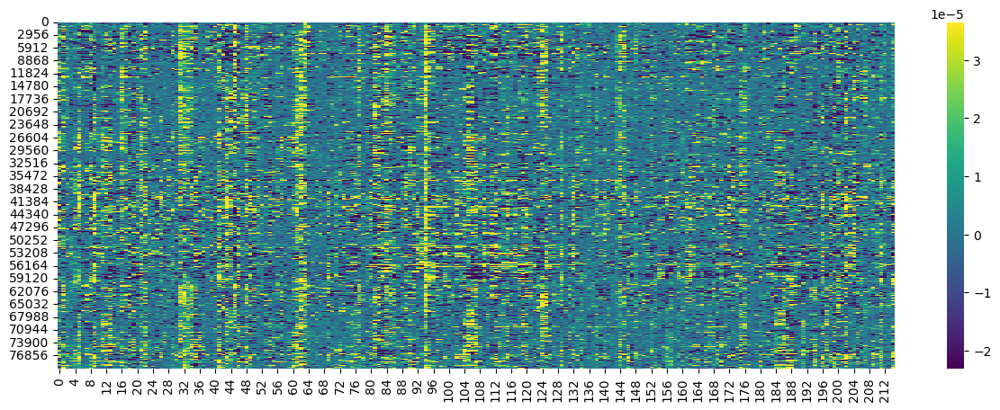

In [83]:
fig,axs=plt.subplots(1,1,figsize=(15,5))
ets_to_plot = edge_ts.sel(TEs='32.2x32.2').T
sns.heatmap(edge_ts.sel(TEs='32.2x32.2').T,cmap='viridis', vmin=ets_to_plot.quantile(.05).values, vmax=ets_to_plot.quantile(.95).values)

In [82]:
ets_to_plot.quantile(.95).values

array(3.65280315e-05)

In [64]:
pd.DataFrame(roi_ts.sel(ROI='R311',TE='48.1').values * roi_ts.sel(ROI='R364',TE='48.1').values).hvplot(width=1000)

:Curve   [index]   (0)

In [15]:
ts1.shape

(215,)

In [21]:
plot = None
for (ECHO_LABEL,ECHO_TIME) in ECHOES.items():
    if plot is None:
        plot = roi_ts.sel(TE=ECHO_TIME,ROI=REP_ROI01).hvplot(width=1000,label=f'{ECHO_LABEL}={ECHO_TIME}ms', legend='bottom_left')
    else:
        plot = plot * roi_ts.sel(TE=ECHO_TIME,ROI=REP_ROI01).hvplot(width=1000,label=f'{ECHO_LABEL}={ECHO_TIME}ms', legend='bottom_left')
plot_209 = plot.opts(opts.Overlay(title='Represenative ROI Timeseries: LH Vis 209 | Left MT'))

In [22]:
plot = None
for (ECHO_LABEL,ECHO_TIME) in ECHOES.items():
    if plot is None:
        plot = roi_ts.sel(TE=ECHO_TIME,ROI=REP_ROI02).hvplot(width=1000,label=f'{ECHO_LABEL}={ECHO_TIME}ms')
    else:
        plot = plot * roi_ts.sel(TE=ECHO_TIME,ROI=REP_ROI02).hvplot(width=1000,label=f'{ECHO_LABEL}={ECHO_TIME}ms')
plot_008 = plot.opts(opts.Overlay(title='Represenative ROI Timeseries: RH Vis 008 | Right MT'))

In [23]:
(plot_008*hv.VLine(REP_TR).opts(line_color='k',line_width=0.5)+plot_209*hv.VLine(REP_TR).opts(line_color='k',line_width=0.5)).cols(1)

:Layout
   .Overlay.I  :Overlay
      .Curve.E01_equals_16_full_stop_3ms :Curve   [TR]   (BOLD Signal (spc))
      .Curve.E02_equals_32_full_stop_2ms :Curve   [TR]   (BOLD Signal (spc))
      .Curve.E03_equals_48_full_stop_1ms :Curve   [TR]   (BOLD Signal (spc))
      .VLine.I                           :VLine   [x,y]
   .Overlay.II :Overlay
      .Curve.E01_equals_16_full_stop_3ms :Curve   [TR]   (BOLD Signal (spc))
      .Curve.E02_equals_32_full_stop_2ms :Curve   [TR]   (BOLD Signal (spc))
      .Curve.E03_equals_48_full_stop_1ms :Curve   [TR]   (BOLD Signal (spc))
      .VLine.I                           :VLine   [x,y]

In [24]:
scat_209 = roi_ts.sel(ROI=REP_ROI01,TR=REP_TR).hvplot.scatter(c='b')
scat_209 = scat_209 * hv.Slope.from_scatter(scat_209).opts(line_width=.5, line_color='b', line_dash='dashed')
scat_008 = roi_ts.sel(ROI=REP_ROI02,TR=REP_TR).hvplot.scatter(c='r')
scat_008 = scat_008 * hv.Slope.from_scatter(scat_008).opts(line_width=.5, line_color='r', line_dash='dashed')
scat_008 * scat_209

:Overlay
   .Scatter.I     :Scatter   [TE]   (BOLD Signal (spc))
   .Annotation.I  :Slope   [x,y]
   .Scatter.II    :Scatter   [TE]   (BOLD Signal (spc))
   .Annotation.II :Slope   [x,y]

***

## Edge Time series

In [25]:
echo_label_combs = [i for i in product(ECHOES.keys(),repeat=2)]
echo_times_combs = [i for i in product(ECHOES.values(),repeat=2)]
echo_times_mults = np.array([i*j for i,j in echo_times_combs]).round(2)

In [26]:
echo_label_combs

[('E01', 'E01'),
 ('E01', 'E02'),
 ('E01', 'E03'),
 ('E02', 'E01'),
 ('E02', 'E02'),
 ('E02', 'E03'),
 ('E03', 'E01'),
 ('E03', 'E02'),
 ('E03', 'E03')]

In [27]:
echo_times_combs

[(16.3, 16.3),
 (16.3, 32.2),
 (16.3, 48.1),
 (32.2, 16.3),
 (32.2, 32.2),
 (32.2, 48.1),
 (48.1, 16.3),
 (48.1, 32.2),
 (48.1, 48.1)]

In [28]:
echo_times_mults

array([ 265.69,  524.86,  784.03,  524.86, 1036.84, 1548.82,  784.03,
       1548.82, 2313.61])

In [29]:
rep_ets = pd.DataFrame(columns=echo_label_combs, index=np.arange(Nacqs))
rep_ets.columns.name = 'ETS'
rep_ets.index.name = 'TR'
rep_ets.shape

(215, 9)

In [30]:
for ECHO_LABEL_i,ECHO_TIME_i in ECHOES.items():
    for ECHO_LABEL_j,ECHO_TIME_j in ECHOES.items():
        rep_ets[(ECHO_LABEL_i,ECHO_LABEL_j)] = roi_ts.sel(ROI=REP_ROI02,TE=ECHO_TIME_i) * roi_ts.sel(ROI=REP_ROI01,TE=ECHO_TIME_j)

In [31]:
rep_ets.hvplot(width=1500, height=350, title='Edge Timseries between left and right MT+', legend='top').opts(legend_cols=9) * hv.VLine(REP_TR).opts(line_color='k',line_width=0.5)

:Overlay
   .NdOverlay.I :NdOverlay   [ETS]
      :Curve   [TR]   (value)
   .VLine.I     :VLine   [x,y]

In [32]:
aux = pd.DataFrame(rep_ets.loc[REP_TR])
aux.columns = ['Signal']
aux['TEs'] = echo_times_mults
aux = aux.reset_index()
scat = aux.hvplot.scatter(x='TEs')
slope, intercept, r_value, p_value, std_err = linregress(echo_times_mults, aux['Signal'])
lin_fit_plot = scat * hv.Slope.from_scatter(scat).opts(line_width=.5, line_color='k', line_dash='dashed')
lin_fit_plot.opts(opts.Overlay(title='Slope=%.1e | Intercept=%.1e | R=%.2f | R^2=%.2f | p_val=%.1e | St.Err=%.1e' % (slope, intercept, r_value,r_value*r_value, p_value, std_err)))

:Overlay
   .Scatter.I    :Scatter   [TEs]   (Signal)
   .Annotation.I :Slope   [x,y]

***

In [ ]:
time_point_select = pn.widgets.Select(name='ROI 1', options=['ROI'+str(r)])

***

## Compute Edge Timeseries

In [33]:
roi_ets = xr.DataArray(dims=['TE','TR','Edge'],
                  coords={'TE':list(ECHOES.values()),
                          'TR':  np.arange(Nacqs),
                          'Edge': np.arange(Ncons)})
roi_ets.name = 'BOLD Signal^2 (spc)'

In [34]:
for (ECHO_LABEL, ECHO_TIME) in tqdm(ECHOES.items(), desc='Echo'):
    aux = get_ets(roi_ts.sel(TE=ECHO_TIME).values)
    roi_ets.loc[ECHO_TIME,:,:] = aux

Echo: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00,  3.57it/s]


In [39]:
roi_ets_mults = xr.DataArray(dims=['Echoes','TR','Edge'],
                            coords={'Echoes':[i+'-'+j for (i,j) in echo_label_combs],
                                     'TR':np.arange(Nacqs),
                                     'Edge':np.arange(Ncons)})

In [40]:
for (ECHO_LABEL_i,_) in ECHOES.items():
    for (ECHO_LABEL_j,_) in ECHOES.items():
        

<xarray.DataArray (Echoes: 9, TR: 215, Edge: 79800)>
array([[[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
...
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]])
Coordinates:
  * Echoes   (Echoes) <U7 'E01-E01' 'E01-E02' 'E01-E03' ... 'E03-E02' 'E03-E03'
  * TR       (TR) int64 0 1 2 3 4 5 6 7 8 ... 207 208 209 210 211 212 213 214
  * Edge     (Edge) int64 0 1 2 3 4 5 6 ... 79794 79795 79796 79797 79798 79799

In [127]:
edge_ts

<xarray.DataArray 'ETS' (TEs: 9, TR: 215, Edge: 79800)>
array([[[ 1.1205098e-05,  9.8672940e-06,  1.1422788e-05, ...,
         -8.3271460e-06, -5.0577920e-06,  1.4269568e-05],
        [-1.5311096e-07,  4.6078800e-06,  1.1261012e-06, ...,
          3.2914200e-05,  2.1134906e-05,  2.7970800e-05],
        [-6.1280020e-07,  2.5872860e-06, -1.6786620e-06, ...,
          1.4695692e-05,  1.1043780e-05,  1.1075515e-05],
        ...,
        [ 2.4924042e-06,  1.4311440e-05,  1.8849402e-06, ...,
          2.2925200e-07, -4.2256720e-08, -4.0374400e-07],
        [ 3.9257026e-07,  5.3302667e-07, -6.9943164e-07, ...,
          7.8416000e-08, -1.8257200e-06, -2.1178352e-08],
        [ 9.5070240e-06,  6.8721520e-06,  2.1189384e-06, ...,
          3.5154756e-05,  1.9511604e-05,  2.4492741e-05]],

       [[-7.6983100e-06,  1.5103728e-05,  1.3722386e-05, ...,
         -1.1730504e-05, -6.0714120e-06,  1.7129298e-05],
        [-1.1180172e-06,  5.9441652e-06,  1.2958652e-06, ...,
          5.6253360e-05,  3.8968418e-05,  5.1572400e-05],
        [-1.3150040e-06,  3.8481060e-06, -1.2441480e-06, ...,
          2.0376444e-05,  3.6534432e-06,  3.6639416e-06],
...
        [ 1.1634389e-05,  2.9721658e-05,  6.0380520e-06, ...,
          7.5873700e-06,  7.0518350e-06,  6.8070450e-06],
        [ 1.7235552e-05, -1.2030336e-05,  1.5944160e-05, ...,
          1.4382676e-05,  1.1383141e-05,  2.0808249e-05],
        [ 4.0148600e-05,  1.7737880e-05,  1.3506320e-05, ...,
          1.3088271e-04,  8.4206250e-05,  7.5487500e-05]],

       [[ 7.7849310e-06, -3.7697550e-06, -3.3253440e-06, ...,
          2.2233610e-05,  7.3770060e-06,  1.5957435e-05],
        [ 1.8159544e-08, -7.9784887e-06, -2.6340964e-06, ...,
          1.2296950e-04,  7.2755750e-05,  1.7139140e-04],
        [ 9.1205040e-07,  1.0641174e-05, -2.0181840e-06, ...,
          7.1168436e-05,  4.0004208e-05,  3.6797868e-05],
        ...,
        [ 6.0610980e-06,  3.7637959e-05,  2.7336397e-06, ...,
          1.3538175e-05,  7.2428300e-06,  6.9914100e-06],
        [ 3.9829248e-05, -4.7900448e-07,  2.2248192e-05, ...,
          2.6022381e-05,  7.2064300e-06,  1.3173270e-05],
        [ 6.5073040e-05,  2.4152200e-05,  2.6413760e-05, ...,
          2.0089740e-04,  1.1459535e-04,  1.0273010e-04]]])
Coordinates:
  * TEs      (TEs) <U9 '16.3x16.3' '16.3x32.2' ... '48.1x32.2' '48.1x48.1'
  * TR       (TR) int64 0 1 2 3 4 5 6 7 8 ... 207 208 209 210 211 212 213 214
  * Edge     (Edge) <U9 'R000-R001' 'R000-R002' ... 'R397-R399' 'R398-R399'